In [35]:
import os
import email
from collections import Counter
import numpy as np

from nltk.corpus import stopwords

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import cross_val_score

from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, confusion_matrix

In [2]:
types = Counter()
msgs = []
trigger = True
for root,dirs,files in os.walk('/Users/taddbackus/School/fall23/qtw/cs3/SpamAssassinMessages/'):
    for f in files:
        with open(os.path.join(root,f),'r',encoding='latin-1') as file_handle:
            msg = email.message_from_file(file_handle,)
            type_ = msg.get_content_type()
            types[type_]+=1
            if type_ == 'multipart/mixed' and trigger:
                print(root,f)
                print('______________')
                trigger = False
                SAMPLE = msg.get_payload()
print(types)


/Users/taddbackus/School/fall23/qtw/cs3/SpamAssassinMessages/spam 0343.0630afbe4ee1ffd0db0ffb81c6de98de
______________
Counter({'text/plain': 7414, 'text/html': 1193, 'multipart/alternative': 326, 'multipart/signed': 180, 'multipart/mixed': 179, 'multipart/related': 56, 'multipart/report': 5, 'text/plain charset=us-ascii': 1})


In [3]:
def return_txt(msg):
    if msg.get_content_type() == 'text/plain':
        return msg.get_payload()
    if msg.get_content_type() == 'text/html':
        return "***Austin is better at beautiful soup than me"
    else:
        for item in msg.get_payload():
            return return_txt(item)
            break

In [4]:
file_names = []
label = []
messages = []
msgType = []
htmlMsgs = []
msgToFix = []
for root,dirs,files in os.walk('/Users/taddbackus/School/fall23/qtw/cs3/SpamAssassinMessages/'):
    for f in files:
        with open(os.path.join(root,f),'r',encoding='latin-1') as file_handle:
            msg = email.message_from_file(file_handle)
            try:
                text = return_txt(msg)
                if '***Austin' in text:
                    htmlMsgs.append([text,root,f])
                else:
                    messages.append(return_txt(msg))
                    if 'spam' in root:
                        label.append(1)
                    else:
                        label.append(0)
            except:
                msgToFix.append(os.path.join(root,f))
                print(f"{root,f} failed to parse")

('/Users/taddbackus/School/fall23/qtw/cs3/SpamAssassinMessages/spam', '00467.5b733c506b7165424a0d4a298e67970f') failed to parse
('/Users/taddbackus/School/fall23/qtw/cs3/SpamAssassinMessages/spam', '0478.16f274ffd3e884a574c9461012cadea6') failed to parse
('/Users/taddbackus/School/fall23/qtw/cs3/SpamAssassinMessages/spam_2', '00204.4cf15f97b8ea08bfafab7d5091b8fbe7') failed to parse
('/Users/taddbackus/School/fall23/qtw/cs3/SpamAssassinMessages/spam_2', '01214.973b4598b630a989967ff69b19f95d4a') failed to parse


In [63]:
for file in msgToFix:
    with open(file,'r',encoding='latin-1') as badFile:
        msg = email.message_from_file(badFile)
        for m in msg:
            print(m[2])

t
l
c
c
c
s
o


IndexError: string index out of range

In [5]:
print(len(messages))
print(len(label))
print(len(htmlMsgs))

8044
8044
1306


In [6]:
messagesClean = []
for i in messages:
    words = i.split()
    filtered_words = [word for word in words if word.lower() not in stopwords.words('english')]
    messagesClean.append(' '.join(filtered_words))


['\x00\x00\x00\x01Bud1\x00\x00\x10\x00\x00\x00\x08\x00\x00\x00\x10\x00\x00\x00\x00%\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x04\x00s\x00p\x00a\x00mvSrnlong\x00\x00\x00\x01\x00\x00\x00\x02\x00\x00\x00\x00\x00\x00\x00\x01\x00\x00\x00\x01\x00\x00\x10\x00vSrnlong\x00\x00\x00\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\

In [7]:
for i in messagesClean:
    print(i)

   Bud1           %                       s p a mvSrnlong                   vSrnlong                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         

In [8]:
vectorizer = CountVectorizer()
textVector = vectorizer.fit_transform(messagesClean)

In [9]:
kMeans = KMeans(random_state=42)
kMeans.fit(textVector)

/Users/taddbackus/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


KMeans(random_state=42)

In [10]:
textData = textVector.toarray()
textData.shape

(8044, 76772)

In [11]:
cluster_column = np.array(kMeans.labels_).reshape(-1, 1)
textClusters = np.hstack((textData,cluster_column))
textClusters.shape

(8044, 76773)

In [16]:
X_train, x_test, y_train, y_test = train_test_split(textClusters,label,test_size=0.2,random_state=42)

In [12]:
nb = MultinomialNB()

In [13]:
nb.fit(textClusters,label)

MultinomialNB()

In [14]:
cross_val_score(nb,textClusters,label,cv=5,n_jobs=-1,scoring='accuracy')

array([0.96643878, 0.99192045, 0.9844624 , 0.98259789, 0.98196517])

In [17]:
nb = MultinomialNB()
nb.fit(X_train,y_train)

MultinomialNB()

In [34]:
yScore = nb.predict_proba(x_test)[:,1]
yClass = nb.predict(x_test)

In [25]:
print(len(y_test))
print(len(yScore))

1609
1609


In [30]:
fpr, tpr, threshold = roc_curve(y_test,yScore)
roc_auc = auc(fpr,tpr)

In [32]:
for i,j,k in zip(fpr,tpr,threshold):
    print(i,j,k)

0.0 0.0 2.0
0.0007547169811320754 0.823943661971831 1.0
0.0007547169811320754 0.8309859154929577 0.9999999999997726
0.0007547169811320754 0.8380281690140845 0.9999999999864144
0.0007547169811320754 0.852112676056338 0.9999999998917701
0.0007547169811320754 0.8591549295774648 0.9999999975063361
0.0007547169811320754 0.8661971830985915 0.9999999967617441
0.0007547169811320754 0.8732394366197183 0.9999999915797275
0.0007547169811320754 0.8802816901408451 0.9999999693267232
0.0007547169811320754 0.9014084507042254 0.9999962981409589
0.0015094339622641509 0.9014084507042254 0.9999565893749924
0.0015094339622641509 0.971830985915493 0.000667110816294755
0.0030188679245283017 0.971830985915493 0.0005066494268550934
0.0030188679245283017 0.9788732394366197 7.174051824008114e-05
0.018867924528301886 0.9788732394366197 2.3373528015066535e-08
0.020377358490566037 0.9788732394366197 1.2991989834264843e-08
0.020377358490566037 0.9823943661971831 8.133214349307022e-09
0.02943396226415094 0.982394366

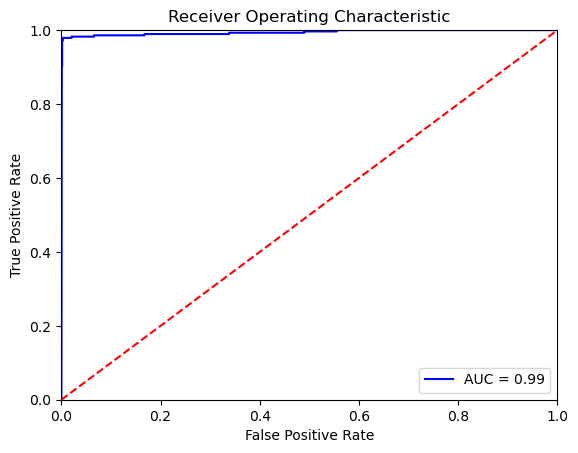

In [31]:
plt.title('Receiver Operating Characteristic')
plt.plot(fpr, tpr, 'b', label = 'AUC = %0.2f' % roc_auc)
plt.legend(loc = 'lower right')
plt.plot([0, 1], [0, 1],'r--')
plt.xlim([0, 1])
plt.ylim([0, 1])
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.show()

In [36]:
confusion_matrix(y_test,yClass)

array([[1323,    2],
       [  14,  270]])